In [4]:
import torch
import torchvision
import torchvision.transforms as transforms

torch.manual_seed(15)

transform = transforms.ToTensor()

trainset = torchvision.datasets.CIFAR10(
    root='./data',
    train=True,
    download=True,
    transform=transform
)

selected_classes = [0, 1]
samples_per_class = 25

all_targets = torch.tensor(trainset.targets)

indices_per_class = []
for c in selected_classes:
    cls_idx = (all_targets == c).nonzero(as_tuple=True)[0]        
    cls_idx = cls_idx[torch.randperm(len(cls_idx))[:samples_per_class]]
    indices_per_class.append(cls_idx)

indices = torch.cat(indices_per_class)

data_subset = torch.stack([trainset[i][0] for i in indices])
targets_subset = all_targets[indices]

print('Subset shape:', data_subset.shape)
print('Subset labels:', targets_subset.shape)
print('Class distribution:', torch.bincount(targets_subset))


Files already downloaded and verified
Subset shape: torch.Size([50, 3, 32, 32])
Subset labels: torch.Size([50])
Class distribution: tensor([25, 25])


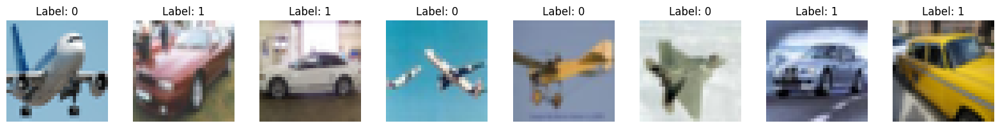

In [5]:
import matplotlib.pyplot as plt

fig, axs = plt.subplots(1, 8, figsize=(16, 2))
for i in range(8):
    idx = torch.randint(0, data_subset.shape[0], (1,)).item()
    img = data_subset[idx]
    label = targets_subset[idx].item()
    axs[i].imshow(img.permute(1, 2, 0).numpy())
    axs[i].set_title(f"Label: {label}")
    axs[i].axis('off')
plt.tight_layout()
plt.show()


In [6]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import TensorDataset, DataLoader
import numpy as np
from pyhessian import hessian
import os
from joblib import Parallel, delayed


class Net(nn.Module):
    def __init__(self, in_dim):
        super().__init__()
        self.net = nn.Sequential(
            nn.Linear(in_dim, 25),
            nn.ReLU(),
            nn.Linear(25, 25), 
            nn.ReLU(),
            nn.Linear(25, 1)
        )
    def forward(self, x):
        return self.net(x)


def get_orthogonal_directions(model):
    torch.manual_seed(seed)
    params = []
    for p in model.parameters():
        params.append(p.data.view(-1))
    w = torch.cat(params)
    d1 = torch.randn_like(w)
    d1 /= torch.norm(d1)
    d2 = torch.randn_like(w)
    d2 -= d2.dot(d1) * d1
    d2 /= torch.norm(d2)
    return w, d1, d2


def train_one_init_worker(alpha_beta_tuple, origin = False, weight_decay = 0, momentum = 0, mode='converge'): 
    
    alpha_item, beta_item = alpha_beta_tuple
    
    
    alpha = torch.tensor(alpha_item)
    beta = torch.tensor(beta_item)
    
    
    device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")
    
    
    X_dev = X.to(device)
    y_dev = y.to(device)
    
    
    torch.manual_seed(seed)
    model = Net(X.shape[1])
    model.to(device) 
    
    criterion = nn.MSELoss()
    
    
    if origin: 
        w_new = alpha * d1 + beta * d2 
    else:
        w_new = w + alpha * d1 + beta * d2 
    pointer = 0
    with torch.no_grad():
        for p in model.parameters():
            numel = p.numel()
            p.copy_(w_new[pointer:pointer+numel].view_as(p))
            pointer += numel

    optimizer = optim.SGD(model.parameters(), lr=lr, momentum=momentum, weight_decay=weight_decay)
    outcome = 'non-global min or saddle'
    mse = float('inf')
    epoch = 0 

    if mode == 'converge':
        used_epochs_ = epochs_
    else:
        used_epochs_ = 50

    
    for epoch in range(used_epochs_):
        model.train()
        optimizer.zero_grad()
        preds = model(X_dev)
        loss = criterion(preds, y_dev)
        loss.backward()
        optimizer.step()
        
        mse = loss.item()
        if mse > 1e4:
            outcome = 'diverge'
            break
        elif mse < loss_threshold:
            outcome = 'converge'
            break
            
    
    final_norm = 0.0
    train_acc = 0.0
    final_sharpness = 0.0

    if outcome != 'diverge': 
        with torch.no_grad():
            params = []
            for p in model.parameters():
                params.append(p.data.cpu().view(-1)) 
            full_vec = torch.cat(params)
            final_norm = torch.norm(full_vec).item()
            
            preds_cls = (preds >= 0.5).float()
            train_acc = (preds_cls == y_dev).float().mean().item()

        
        model.to("cpu") 
        hessian_comp = hessian(model, criterion, data=(X, y), cuda=False)
        top_eigenvalues, _ = hessian_comp.eigenvalues()
        final_sharpness = top_eigenvalues[0]
    
    
    print(f"(α={alpha_item:.3f}, β={beta_item:.3f}): {outcome}, loss={mse:.6f}, acc={train_acc:.3f}, norm={final_norm:.4f}, sharp={final_sharpness:.4f}, epoch={epoch}")
    

    return (alpha_item, beta_item, outcome, mse, final_norm, final_sharpness, train_acc, epoch)



In [7]:
seed = 15
torch.manual_seed(seed)

X = data_subset.view(data_subset.size(0), -1).float()
y = targets_subset.float().unsqueeze(1)

lr = 0.05
epochs_ = 3000
origin = True
loss_threshold = 5e-4
weight_decay = 1e-3
momentum = 0
mode = 'converge'

n_points = 300
alphas = torch.linspace(32, 42, n_points)
betas = torch.linspace(16, 24, n_points)

ref_model = Net(X.shape[1])
w, d1, d2 = get_orthogonal_directions(ref_model) 

all_pairs = []
for alpha in alphas:
    for beta in betas:
        all_pairs.append((alpha.item(), beta.item()))

n_cores = os.cpu_count()
results = Parallel(n_jobs=n_cores, verbose=0)(
    delayed(train_one_init_worker)(pair, origin=origin, momentum=momentum, weight_decay=weight_decay, mode=mode) for pair in all_pairs
)

/Users/shuang/opt/anaconda3/envs/phomology/lib/python3.10/site-packages/torch/autograd/__init__.py:200: UserWarning: Using backward() with create_graph=True will create a reference cycle between the parameter and its gradient which can cause a memory leak. We recommend using autograd.grad when creating the graph to avoid this. If you have to use this function, make sure to reset the .grad fields of your parameters to None after use to break the cycle and avoid the leak. (Triggered internally at /Users/runner/work/pytorch/pytorch/pytorch/torch/csrc/autograd/engine.cpp:1156.)
  Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass
/Users/shuang/opt/anaconda3/envs/phomology/lib/python3.10/site-packages/torch/autograd/__init__.py:200: UserWarning: Using backward() with create_graph=True will create a reference cycle between the parameter and its gradient which can cause a memory leak. We recommend using autograd.grad when creating the graph to avoid

(α=32.000, β=16.107): converge, loss=0.000498, acc=1.000, norm=35.0966, sharp=37.6183, epoch=424
(α=32.000, β=16.054): converge, loss=0.000491, acc=1.000, norm=35.0155, sharp=37.1678, epoch=457
(α=32.000, β=16.241): converge, loss=0.000498, acc=1.000, norm=35.0709, sharp=39.2896, epoch=471
(α=32.000, β=16.080): converge, loss=0.000482, acc=1.000, norm=35.0221, sharp=37.5884, epoch=460


/Users/shuang/opt/anaconda3/envs/phomology/lib/python3.10/site-packages/torch/autograd/__init__.py:200: UserWarning: Using backward() with create_graph=True will create a reference cycle between the parameter and its gradient which can cause a memory leak. We recommend using autograd.grad when creating the graph to avoid this. If you have to use this function, make sure to reset the .grad fields of your parameters to None after use to break the cycle and avoid the leak. (Triggered internally at /Users/runner/work/pytorch/pytorch/pytorch/torch/csrc/autograd/engine.cpp:1156.)
  Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass
/Users/shuang/opt/anaconda3/envs/phomology/lib/python3.10/site-packages/torch/autograd/__init__.py:200: UserWarning: Using backward() with create_graph=True will create a reference cycle between the parameter and its gradient which can cause a memory leak. We recommend using autograd.grad when creating the graph to avoid

(α=32.000, β=16.027): converge, loss=0.000499, acc=1.000, norm=34.8748, sharp=40.1040, epoch=529
(α=32.000, β=16.161): converge, loss=0.000487, acc=1.000, norm=34.9418, sharp=38.3592, epoch=524
(α=32.000, β=16.134): converge, loss=0.000479, acc=1.000, norm=34.9093, sharp=39.4652, epoch=536
(α=32.000, β=16.000): converge, loss=0.000482, acc=1.000, norm=34.7578, sharp=38.7400, epoch=590
(α=32.000, β=16.187): converge, loss=0.000499, acc=1.000, norm=34.8772, sharp=40.0717, epoch=568
(α=32.000, β=16.214): converge, loss=0.000498, acc=1.000, norm=34.9165, sharp=38.6808, epoch=552
(α=32.000, β=16.294): converge, loss=0.000494, acc=1.000, norm=35.0826, sharp=39.0133, epoch=478
(α=32.000, β=16.268): converge, loss=0.000492, acc=1.000, norm=35.0101, sharp=34.5445, epoch=514
(α=32.000, β=16.321): converge, loss=0.000469, acc=1.000, norm=35.0574, sharp=36.8527, epoch=499
(α=32.000, β=16.401): converge, loss=0.000482, acc=1.000, norm=35.0408, sharp=39.1876, epoch=529
(α=32.000, β=16.375): converge

In [8]:
seed = 15
torch.manual_seed(seed)

X = data_subset.view(data_subset.size(0), -1).float()
y = targets_subset.float().unsqueeze(1)

lr = 0.05
epochs_ = 3000
origin = True
loss_threshold = 5e-4
weight_decay = 1e-3
momentum = 0
mode = 'converge'

n_points = 300
alphas = torch.linspace(38.5, 39, n_points)
betas = torch.linspace(18.5, 19, n_points)

ref_model = Net(X.shape[1])
w, d1, d2 = get_orthogonal_directions(ref_model) 

all_pairs = []
for alpha in alphas:
    for beta in betas:
        all_pairs.append((alpha.item(), beta.item()))

n_cores = os.cpu_count()
results_small = Parallel(n_jobs=n_cores, verbose=0)(
    delayed(train_one_init_worker)(pair, origin=origin, momentum=momentum, weight_decay=weight_decay, mode=mode) for pair in all_pairs
)

(α=38.500, β=18.505): converge, loss=0.000497, acc=1.000, norm=44.8571, sharp=34.5079, epoch=692
(α=38.500, β=18.502): converge, loss=0.000494, acc=1.000, norm=44.8535, sharp=34.8043, epoch=688
(α=38.500, β=18.500): converge, loss=0.000496, acc=1.000, norm=44.8452, sharp=34.9591, epoch=689
(α=38.500, β=18.503): converge, loss=0.000493, acc=1.000, norm=44.8087, sharp=35.0122, epoch=711
(α=38.500, β=18.513): converge, loss=0.000494, acc=1.000, norm=44.8776, sharp=34.8626, epoch=697
(α=38.500, β=18.510): converge, loss=0.000495, acc=1.000, norm=44.8402, sharp=34.7051, epoch=708
(α=38.500, β=18.508): converge, loss=0.000499, acc=1.000, norm=44.7398, sharp=34.2688, epoch=750
(α=38.500, β=18.517): converge, loss=0.000494, acc=1.000, norm=44.9083, sharp=34.7520, epoch=689
(α=38.500, β=18.522): converge, loss=0.000495, acc=1.000, norm=44.9410, sharp=34.5529, epoch=683
(α=38.500, β=18.523): converge, loss=0.000499, acc=1.000, norm=44.9258, sharp=34.5190, epoch=696
(α=38.500, β=18.525): converge

In [12]:
# import pickle

# with open("output/result.pkl", "wb") as f:
#     pickle.dump(results, f)


# with open("output/result_small.pkl", "wb") as f:
#     pickle.dump(results_small, f)

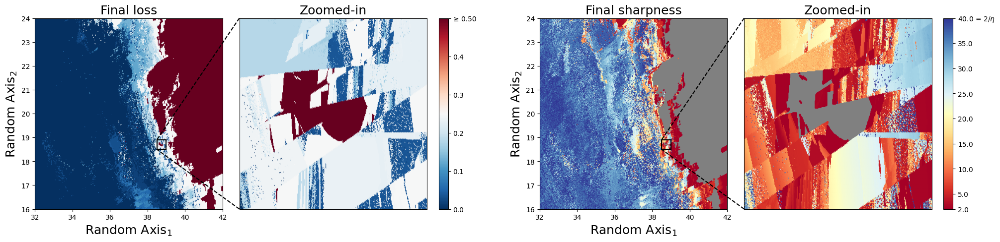

In [14]:
import matplotlib.gridspec as gridspec


mycolormap = 'RdBu_r'
mycolormap2 = 'RdYlBu'


fig = plt.figure(figsize=(24.5, 5))

lr = 0.05

outer_gs = gridspec.GridSpec(1, 2, figure=fig, width_ratios=[1, 1], wspace=0.15)

gs_loss = gridspec.GridSpecFromSubplotSpec(1, 2, subplot_spec=outer_gs[0], 
                                           width_ratios=[1, 1.25], wspace=0.08)

gs_sharp = gridspec.GridSpecFromSubplotSpec(1, 2, subplot_spec=outer_gs[1], 
                                            width_ratios=[1, 1.25], wspace=0.08)


ax0 = fig.add_subplot(gs_loss[0])
ax1 = fig.add_subplot(gs_loss[1])
ax2 = fig.add_subplot(gs_sharp[0])
ax3 = fig.add_subplot(gs_sharp[1])


axs = [ax0, ax1, ax2, ax3]


FS = 18


alpha_list = [r[0] for r in results]
beta_list = [r[1] for r in results]
outcomelist = [r[2] for r in results]
losslist = [r[3] for r in results]
norm = [r[4] for r in results]
sharpness = [r[5] for r in results]
acclist = [r[6] for r in results]
epochlist = [r[7] for r in results] 

ax = axs[0]
sc0 = ax.scatter(alpha_list, beta_list, c=losslist, s=.5, vmax=0.5, cmap=mycolormap)
ax.set_xlabel(r'Random Axis$_1$', fontsize=FS)
ax.set_ylabel(r'Random Axis$_2$', fontsize=FS)
ax.set_xlim(min(alpha_list), max(alpha_list))
ax.set_ylim(min(beta_list), max(beta_list))
ax.set_title('Final loss', fontsize=FS)



ax = axs[2]
converge_indices = [i for i, o in enumerate(outcomelist) if (o != 'diverge')] 
alpha_converge = [alpha_list[i] for i in converge_indices]
beta_converge = [beta_list[i] for i in converge_indices]
norm_converge = [norm[i] for i in converge_indices]
sharpness_converge = [sharpness[i] for i in converge_indices]
sc1 = ax.scatter(alpha_converge, beta_converge, c=sharpness_converge, cmap=mycolormap2, s=.5, vmax=2/lr) 
ax.set_xlim(min(alpha_list), max(alpha_list))
ax.set_ylim(min(beta_list), max(beta_list))
ax.set_xlabel(r'Random Axis$_1$', fontsize=FS)
ax.set_ylabel(r'Random Axis$_2$', fontsize=FS)
ax.set_title('Final sharpness', fontsize=FS)








alpha_list = [r[0] for r in results_small]
beta_list = [r[1] for r in results_small]
outcomelist = [r[2] for r in results_small]
losslist = [r[3] for r in results_small]
norm = [r[4] for r in results_small]
sharpness = [r[5] for r in results_small]
acclist = [r[6] for r in results_small]
epochlist = [r[7] for r in results_small] 


ax = axs[1]
sc0 = ax.scatter(alpha_list, beta_list, c=losslist, s=4, vmax=0.5, cmap=mycolormap)
cb0 = plt.colorbar(sc0, ax=ax) 
ax.set_xlim(min(alpha_list), max(alpha_list))
ax.set_ylim(min(beta_list), 18.9)
cb0_ticks = cb0.get_ticks()
cb0_ticks[0] = min(losslist)
cb0_ticklabels = [f"{tick:.1f}" if tick < 0.5 else "≥ 0.50" for tick in cb0_ticks]
cb0.set_ticks(cb0_ticks)
cb0.set_ticklabels(cb0_ticklabels)
ax.set_yticks([])
ax.set_xticks([])
ax.set_title('Zoomed-in', fontsize=FS)

ax = axs[3]
converge_indices = [i for i, o in enumerate(outcomelist) if (o != 'diverge')] 
alpha_converge = [alpha_list[i] for i in converge_indices]
beta_converge = [beta_list[i] for i in converge_indices]
norm_converge = [norm[i] for i in converge_indices]
sharpness_converge = [sharpness[i] for i in converge_indices]
sc1 = ax.scatter(alpha_converge, beta_converge, c=sharpness_converge, cmap=mycolormap2, s=4, vmax=2/lr) 
cb1 = plt.colorbar(sc1, ax=ax)
cb1_ticks = cb1.get_ticks()
cb1_ticks[0] = min(sharpness_converge)
cb1_ticklabels = [f"{tick:.1f}" if tick < 40 else r"40.0 = $2/\eta$" for tick in cb1_ticks]
cb1.set_ticks(cb1_ticks)
cb1.set_ticklabels(cb1_ticklabels)
ax.set_xlim(min(alpha_list), max(alpha_list))
ax.set_ylim(min(beta_list), 18.9)
ax.set_yticks([])
ax.set_xticks([])
ax.set_title('Zoomed-in', fontsize=FS)


import matplotlib.patches as patches
rect1 = patches.Rectangle((38.5, 18.5), 0.5, 0.4, linewidth=1.5, edgecolor='black', facecolor='none')
rect2 = patches.Rectangle((38.5, 18.5), 0.5, 0.4, linewidth=1.5, edgecolor='black', facecolor='none')
axs[0].add_patch(rect1)
axs[2].add_patch(rect2)
from mpl_toolkits.axes_grid1.inset_locator import mark_inset
mark_inset(axs[0], axs[1], loc1=3, loc2=2, fc="none", ec="black", lw=1.5, linestyle='--')
mark_inset(axs[2], axs[3], loc1=3, loc2=2, fc="none", ec="black", lw=1.5, linestyle='--')


axs[2].set_facecolor('grey')
axs[3].set_facecolor('grey')

plt.savefig('output/Fig5.png', bbox_inches='tight', dpi=300)